In [1]:
import numpy  as np
import pandas as pd
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import Ridge,Lasso, LinearRegression,RidgeCV,LassoCV,ElasticNet,ElasticNetCV,LogisticRegression
from sklearn.model_selection import train_test_split
import statsmodels.api as sm
import matplotlib.pyplot as plt
import seaborn as sns
import pickle
from pandas_profiling import ProfileReport

In [2]:
df=pd.read_csv(r"C:\Users\lenov\Downloads\diabetes.csv")
df

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148,72,35,0,33.6,0.627,50,1
1,1,85,66,29,0,26.6,0.351,31,0
2,8,183,64,0,0,23.3,0.672,32,1
3,1,89,66,23,94,28.1,0.167,21,0
4,0,137,40,35,168,43.1,2.288,33,1
...,...,...,...,...,...,...,...,...,...
763,10,101,76,48,180,32.9,0.171,63,0
764,2,122,70,27,0,36.8,0.340,27,0
765,5,121,72,23,112,26.2,0.245,30,0
766,1,126,60,0,0,30.1,0.349,47,1


In [3]:
pf=ProfileReport(df)
pf

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [4]:
df.isnull().sum()

Pregnancies                 0
Glucose                     0
BloodPressure               0
SkinThickness               0
Insulin                     0
BMI                         0
DiabetesPedigreeFunction    0
Age                         0
Outcome                     0
dtype: int64

In [4]:
df['BMI']=df['BMI'].replace(0,df['BMI'].mean())

In [5]:
df['BloodPressure']=df['BloodPressure'].replace(0,df['BloodPressure'].mean())

In [6]:
df['Glucose']=df['Glucose'].replace(0,df['Glucose'].mean())

In [7]:
df['Insulin']=df['Insulin'].replace(0,df['Insulin'].mean())

In [8]:
df['SkinThickness']=df['SkinThickness'].replace(0,df['SkinThickness'].mean())

In [9]:
ProfileReport(df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [10]:
### finding the outliers in dataset 

In [11]:
import matplotlib.pyplot as plt

<AxesSubplot:>

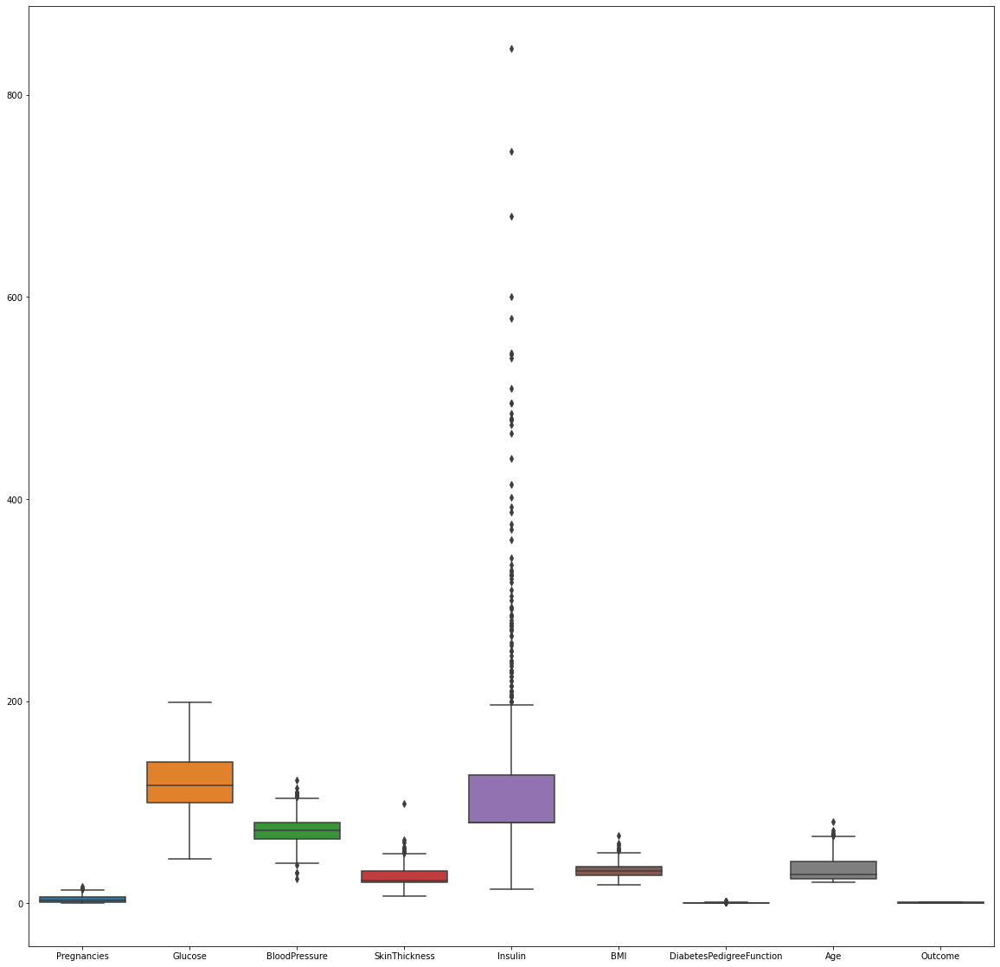

In [12]:
fig,ax=plt.subplots(figsize=(20,20))
sns.boxplot(data=df,ax=ax)


In [13]:
q=df['Pregnancies'].quantile(.98)
df_new=df[df['Pregnancies']<q]

q=df_new['BMI'].quantile(.98)
df_new=df_new[df_new['BMI']<q]

q=df_new['SkinThickness'].quantile(.98)
df_new=df_new[df_new['SkinThickness']<q]

q=df_new['Insulin'].quantile(.98)
df_new=df_new[df_new['Insulin']<q]

q=df_new['DiabetesPedigreeFunction'].quantile(.98)
df_new=df_new[df_new['DiabetesPedigreeFunction']<q]

q=df_new['Age'].quantile(.98)
df_new=df_new[df_new['Age']<q]




In [14]:
df_new

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age,Outcome
0,6,148.0,72.0,35.000000,79.799479,33.6,0.627,50,1
1,1,85.0,66.0,29.000000,79.799479,26.6,0.351,31,0
2,8,183.0,64.0,20.536458,79.799479,23.3,0.672,32,1
3,1,89.0,66.0,23.000000,94.000000,28.1,0.167,21,0
5,5,116.0,74.0,20.536458,79.799479,25.6,0.201,30,0
...,...,...,...,...,...,...,...,...,...
762,9,89.0,62.0,20.536458,79.799479,22.5,0.142,33,0
764,2,122.0,70.0,27.000000,79.799479,36.8,0.340,27,0
765,5,121.0,72.0,23.000000,112.000000,26.2,0.245,30,0
766,1,126.0,60.0,20.536458,79.799479,30.1,0.349,47,1


<AxesSubplot:>

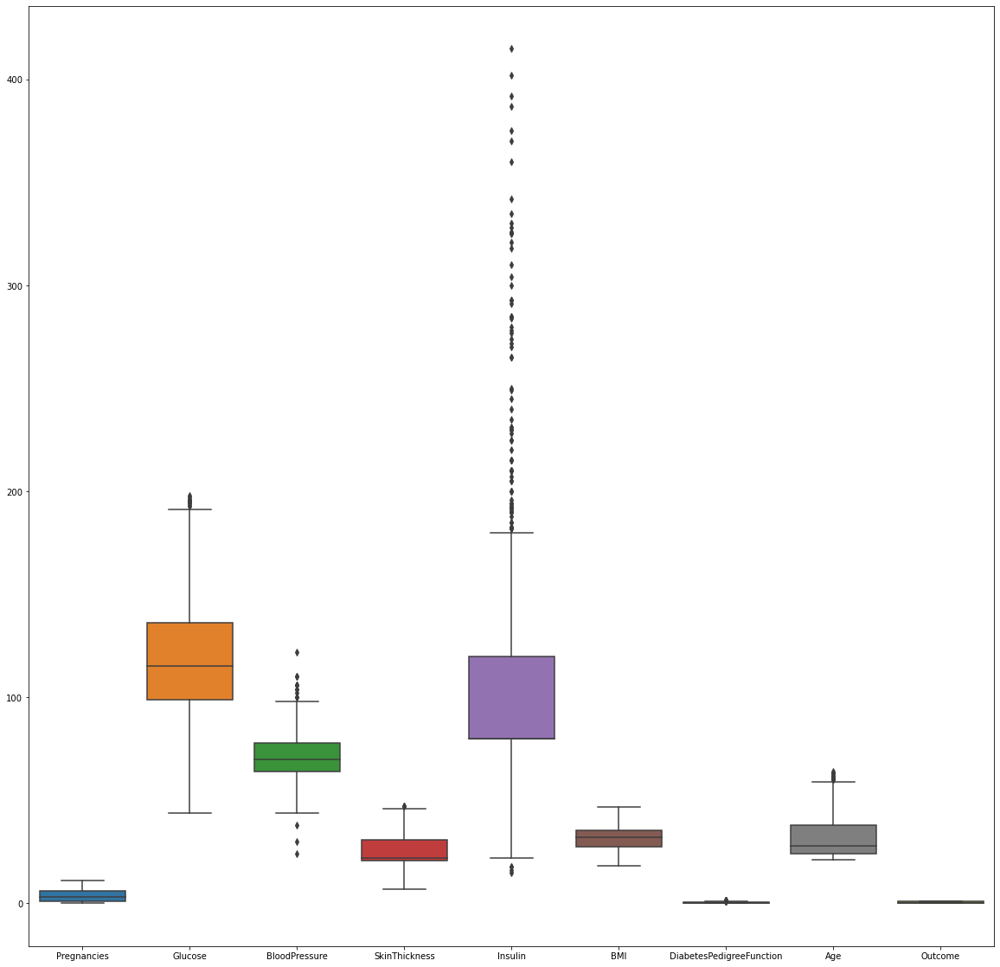

In [15]:
fig,ax=plt.subplots(figsize=(20,20))
sns.boxplot(data=df_new,ax=ax)

In [16]:
y=df_new['Outcome']
y

0      1
1      0
2      1
3      0
5      0
      ..
762    0
764    0
765    0
766    1
767    0
Name: Outcome, Length: 669, dtype: int64

In [17]:
x=df_new.drop(columns=['Outcome'])

In [18]:
x

,Pregnancies,Glucose,BloodPressure,SkinThickness,Insulin,BMI,DiabetesPedigreeFunction,Age
0,6,148.0,72.0,35.000000,79.799479,33.6,0.627,50
1,1,85.0,66.0,29.000000,79.799479,26.6,0.351,31
2,8,183.0,64.0,20.536458,79.799479,23.3,0.672,32
3,1,89.0,66.0,23.000000,94.000000,28.1,0.167,21
5,5,116.0,74.0,20.536458,79.799479,25.6,0.201,30
...,...,...,...,...,...,...,...,...
762,9,89.0,62.0,20.536458,79.799479,22.5,0.142,33
764,2,122.0,70.0,27.000000,79.799479,36.8,0.340,27
765,5,121.0,72.0,23.000000,112.000000,26.2,0.245,30
766,1,126.0,60.0,20.536458,79.799479,30.1,0.349,47


In [19]:
from sklearn.preprocessing import StandardScaler
scaler=StandardScaler()
scaler.fit_transform(df_new)


array([[ 0.80765679,  0.97637196,  0.03317306, ...,  0.69564619,
         1.73812356,  1.44324264],
       [-0.86724213, -1.16775154, -0.47773978, ..., -0.33086961,
        -0.09018566, -0.69288419],
       [ 1.47761635,  2.16755168, -0.64804407, ...,  0.8630129 ,
         0.00604114,  1.44324264],
       ...,
       [ 0.472677  ,  0.05746189,  0.03317306, ..., -0.72511118,
        -0.18641246, -0.69288419],
       [-0.86724213,  0.22763042, -0.98865263, ..., -0.33830813,
         1.44944316,  1.44324264],
       [-0.86724213, -0.89548189, -0.13713122, ..., -0.46476297,
        -0.86000006, -0.69288419]])

In [20]:
ProfileReport(pd.DataFrame(scaler.fit_transform(df_new)))

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

<AxesSubplot:>

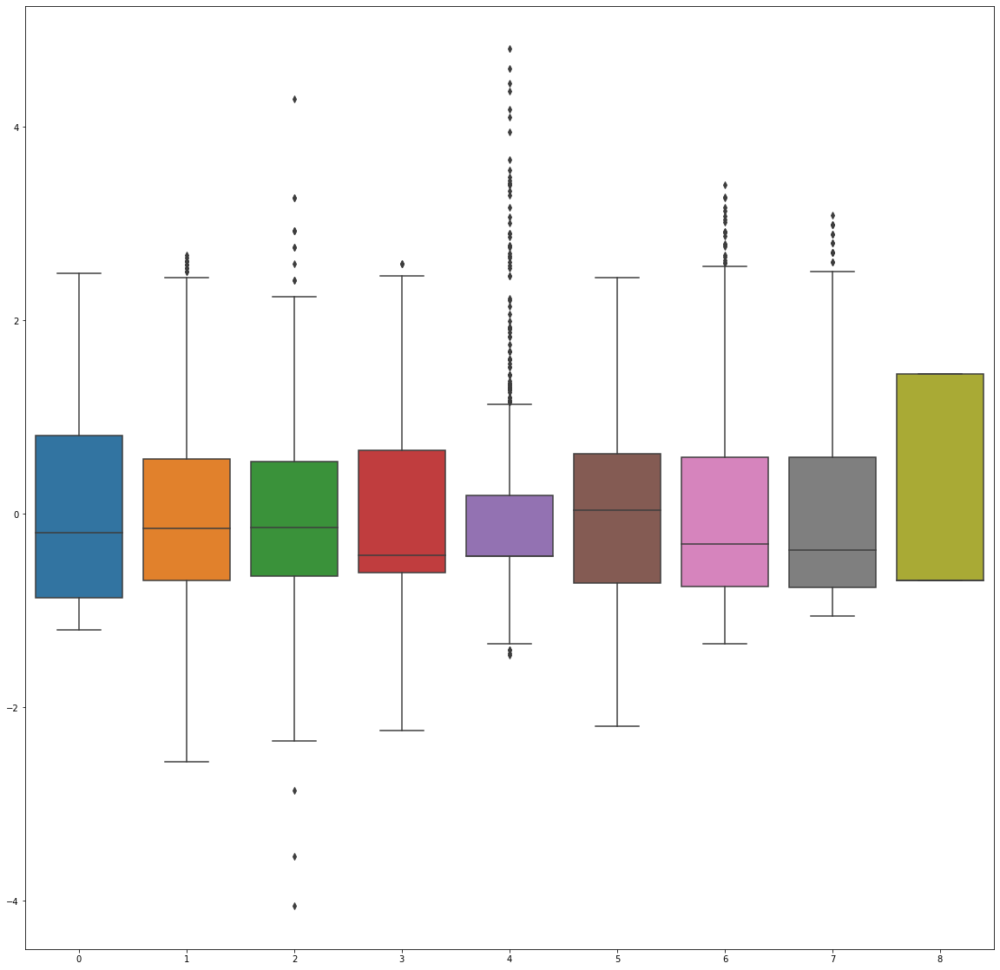

In [21]:
df_new_scaler=pd.DataFrame(scaler.fit_transform(df_new))
fig,ax=plt.subplots(figsize=(20,20))
sns.boxplot(data=df_new_scaler,ax=ax)

In [22]:
from sklearn.preprocessing import StandardScaler
scaler=StandardScaler()
x_data=scaler.fit_transform(x)
x_data

array([[ 0.80765679,  0.97637196,  0.03317306, ...,  0.3012812 ,
         0.69564619,  1.73812356],
       [-0.86724213, -1.16775154, -0.47773978, ..., -0.83209295,
        -0.33086961, -0.09018566],
       [ 1.47761635,  2.16755168, -0.64804407, ..., -1.3663979 ,
         0.8630129 ,  0.00604114],
       ...,
       [ 0.472677  ,  0.05746189,  0.03317306, ..., -0.89685719,
        -0.72511118, -0.18641246],
       [-0.86724213,  0.22763042, -0.98865263, ..., -0.26540588,
        -0.33830813,  1.44944316],
       [-0.86724213, -0.89548189, -0.13713122, ..., -0.2168327 ,
        -0.46476297, -0.86000006]])

In [23]:
y

0      1
1      0
2      1
3      0
5      0
      ..
762    0
764    0
765    0
766    1
767    0
Name: Outcome, Length: 669, dtype: int64

In [24]:
### cheking the multicollinerity

In [25]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
vif_df=pd.DataFrame()
vif_df['vif']=[variance_inflation_factor(x_data,i) for i in range(x_data.shape[1])]


In [26]:
vif_df['feature']=x.columns

In [27]:
vif_df

,vif,feature
0,1.484172,Pregnancies
1,1.338105,Glucose
2,1.237600,BloodPressure
3,1.439654,SkinThickness
4,1.282708,Insulin
5,1.495518,BMI
6,1.037261,DiabetesPedigreeFunction
7,1.701290,Age


In [28]:
def vif_score(x):
    scaler=StandardScaler()
    arr=scaler.fit_transform(x)
    return pd.DataFrame([[x.columns[i],variance_inflation_factor(arr,i)] for i in range(arr.shape[1])],columns=['feature','vif_score'])
    

In [29]:
vif_score(x)

,feature,vif_score
0,Pregnancies,1.484172
1,Glucose,1.338105
2,BloodPressure,1.237600
3,SkinThickness,1.439654
4,Insulin,1.282708
5,BMI,1.495518
6,DiabetesPedigreeFunction,1.037261
7,Age,1.701290


In [40]:
from sklearn.model_selection import train_test_split
x_test,x_train,y_test,y_train=train_test_split(x_data,y, test_size=0.20,random_state=144)

In [67]:
x_test

array([[-0.86724213, -0.45304371, -0.13713122, ...,  0.39842755,
        -1.10819497, -0.95622686],
       [-1.20222191,  0.73813601, -0.21330247, ...,  1.72609441,
        -0.87388159, -0.28263926],
       [-0.86724213,  0.80620343,  0.20347734, ..., -0.89685719,
        -0.68419932, -1.05245366],
       ...,
       [ 1.81259614, -0.45304371, -1.66986975, ..., -0.08730423,
        -0.22301106,  0.96830915],
       [ 1.81259614, -0.96354931, -0.3074355 , ..., -1.22067837,
        -0.89247789,  2.50793796],
       [ 0.13769722,  0.84023713,  0.88469447, ...,  1.0946431 ,
         0.4241402 ,  0.48717515]])

In [41]:
### using logistics regression model

In [42]:
from sklearn.linear_model import LogisticRegression

In [47]:
logr=LogisticRegression(verbose=1)


In [48]:
logr.fit(x_train,y_train)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:    0.0s finished


LogisticRegression(verbose=1)

In [55]:
logr.predict([x_test[0]])

array([0], dtype=int64)

In [56]:
logr.predict_proba([x_test[0]])

array([[0.89112076, 0.10887924]])

In [57]:
logr.predict_log_proba([x_test[0]])

array([[-0.11527532, -2.21751593]])

In [52]:
x_test[0]

array([-0.86724213, -0.45304371, -0.13713122,  0.29166255,  0.42282697,
        0.39842755, -1.10819497, -0.95622686])

In [58]:
logr.score(x_train,y_train)

0.8059701492537313

In [60]:
logr.score(x_test,y_test)

0.7514018691588785

In [61]:
logr_lib=LogisticRegression(verbose=1,    solver='liblinear')

In [62]:
logr_lib.fit(x_train,y_train)

[LibLinear]

LogisticRegression(solver='liblinear', verbose=1)

In [63]:
logr_lib.score(x_train,y_train)

0.8059701492537313

In [64]:
logr_lib.score(x_test,y_test)

0.7532710280373832

In [66]:
y_pred_lib=logr_lib.predict(x_test)
y_pred_lib

array([0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1,
       0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0,
       1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0,
       0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0,
       1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1,
       1, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1,
       1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0,
       0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1,
       0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0,
       0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0,
       1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1,

In [68]:
y_pred_defalut=logr.predict(x_test)
y_pred_defalut

array([0, 0, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1,
       0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0,
       1, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0,
       0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0,
       1, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1,
       1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0,
       0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0, 1, 1, 1, 1, 0, 1,
       1, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 0, 0, 0, 1, 0, 0,
       0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 1, 1,
       0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0,
       0, 1, 0, 1, 1, 0, 0, 0, 1, 0, 1, 0, 0, 1, 0, 1, 1, 0, 0, 0, 0, 0,
       1, 0, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1,
       0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1,

In [71]:
from sklearn.metrics import confusion_matrix,accuracy_score,roc_curve,roc_auc_score

In [72]:
confusion_matrix(y_test,y_pred_lib)

array([[304,  59],
       [ 73,  99]], dtype=int64)

In [73]:
confusion_matrix(y_test,y_pred_defalut)

array([[305,  58],
       [ 75,  97]], dtype=int64)

In [83]:
auc=roc_auc_score(y_test,y_pred_lib)

In [81]:
fpr,tpr,threshold=roc_curve(y_test,y_pred_lib)

In [78]:
roc_auc_score(y_test,y_pred_defalut)

0.7020869370235121

In [79]:
roc_curve(y_test,y_pred_defalut)

(array([0.        , 0.15977961, 1.        ]),
 array([0.        , 0.56395349, 1.        ]),
 array([2, 1, 0], dtype=int64))

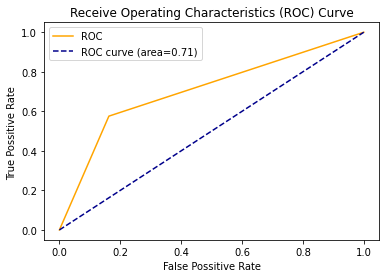

In [87]:
plt.plot(fpr,tpr,color='orange',label='ROC')
plt.plot([0,1],[0,1], color='darkblue',linestyle='--',label='ROC curve (area=%0.2f)'%auc)
plt.xlabel('False Possitive Rate')
plt.ylabel('True Possitive Rate ')
plt.title('Receive Operating Characteristics (ROC) Curve')
plt.legend()
plt.show()